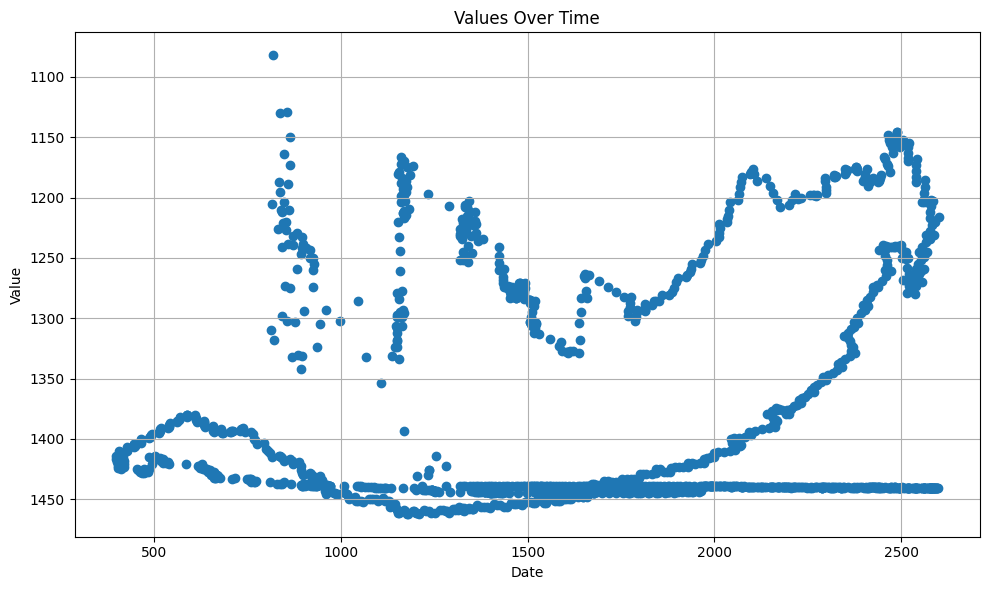

In [10]:

import pandas as pd# Read the Excel file
import matplotlib.pyplot as plt
from gen_insights import apply_smoothing

excel_file = r'C:\Users\k67885\Documents\EyeGaze\output\Processed_Coordinates_1738683934.avi.csv'
df = pd.read_csv(excel_file)  # Specify your sheet name

processed_coords = (df["ScreenX"], df["ScreenY"])

smoothed_coords = apply_smoothing(
         processed_coords[0], processed_coords[1], method="kalman", window_size=5
     )

# Plot the data
plt.figure(figsize=(10, 6))
# plt.plot(df['ScreenX'], df['ScreenY'], marker='o', linestyle='-')
plt.scatter(smoothed_coords[0], smoothed_coords[1], marker='o', linestyle='-')
plt.title('Values Over Time')
plt.xlabel('Date')
plt.ylabel('Value')
plt.grid(True)

plt.gca().invert_yaxis()

plt.tight_layout()
plt.show()

AttributeError: 'tuple' object has no attribute 'shape'

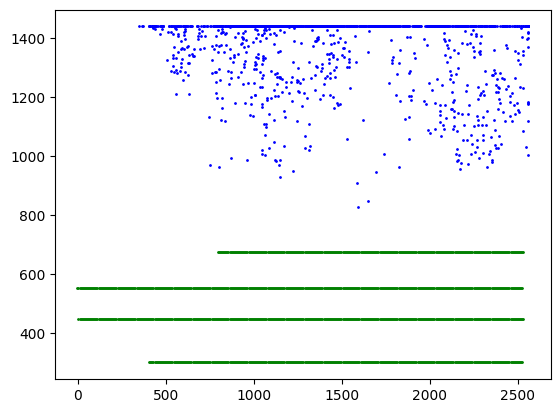

In [11]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

excel_file = r'C:\Users\k67885\Documents\EyeGaze\output\Processed_Coordinates_1738683934.avi.csv'
df = pd.read_csv(excel_file)  # Specify your sheet name

file2 = r'C:\Users\k67885\Documents\EyeGaze\output\Game_Coordinates_1738683934.xlsx'
df2 = pd.read_excel(file2)


processed_coords = (df["ScreenX"], df["ScreenY"])
game_coords = (df2["GameX"], df2["GameY"])


# Visualization
fig, ax = plt.subplots()
scat_game = ax.scatter(processed_coords[0], processed_coords[1], c='blue', s=1, label='Game Coordinates')
scat_screen = ax.scatter(game_coords[0], game_coords[1], c='green', s=1, label='Screen Coordinates')


def update_plot(frame):
    scat_game.set_offsets(processed_coords[frame, [0, 1]])
    scat_screen.set_offsets(game_coords[frame, [0, 1]])
    return scat_game, scat_screen

ani = FuncAnimation(fig, update_plot, frames=processed_coords.shape[0], interval=200, blit=True)

# Display the animation in the notebook
HTML(ani.to_jshtml())


Animation size has reached 20983859 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


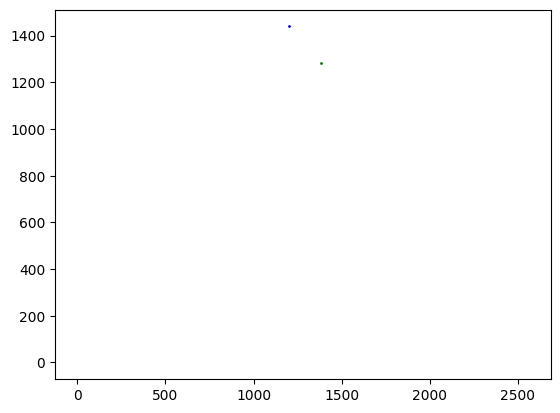

In [13]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Load data
# excel_file = r'C:\Users\k67885\Documents\EyeGaze\output\Processed_Coordinates_1738683934.avi.csv'
excel_file = r'C:\Users\k67885\Documents\EyeGaze\output\Processed_Coordinates_1738684361.avi.csv'
df = pd.read_csv(excel_file)

# file2 = r'C:\Users\k67885\Documents\EyeGaze\output\Game_Coordinates_1738683934.xlsx'
file2 = r'C:\Users\k67885\Documents\EyeGaze\output\Game_Coordinates_1738684361.xlsx'
df2 = pd.read_excel(file2)

# Convert to numpy arrays
processed_coords = np.array([df["ScreenX"].values, df["ScreenY"].values]).T
game_coords = np.array([df2["GameX"].values, df2["GameY"].values]).T

# Visualization
fig, ax = plt.subplots()
scat_game = ax.scatter(processed_coords[:, 0], processed_coords[:, 1], c='blue', s=1, label='Game Coordinates')
scat_screen = ax.scatter(game_coords[:, 0], game_coords[:, 1], c='green', s=1, label='Screen Coordinates')

def update_plot(frame):
    scat_game.set_offsets(processed_coords[frame:frame+1])
    scat_screen.set_offsets(game_coords[frame:frame+1])
    return scat_game, scat_screen

# Create animation
ani = FuncAnimation(fig, update_plot, frames=processed_coords.shape[0], interval=200, blit=True)

# Display animation in the notebook
HTML(ani.to_jshtml())
